<a href="https://colab.research.google.com/github/SidIzG/DataScience/blob/master/NYPD_arrest_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install sodapy

In [2]:
import pandas as pd
from sodapy import Socrata

client = Socrata("data.cityofnewyork.us", None)

results = client.get("uip8-fykc", limit='300000')

arst_df = pd.DataFrame.from_records(results)

In [3]:
arst_df.shape

(39144, 24)

In [4]:
arst_df.head(20)

,arrest_key,arrest_date,pd_cd,pd_desc,ky_cd,ofns_desc,law_code,law_cat_cd,arrest_boro,arrest_precinct,jurisdiction_code,age_group,perp_sex,perp_race,x_coord_cd,y_coord_cd,latitude,longitude,geocoded_column,:@computed_region_f5dn_yrer,:@computed_region_yeji_bk3q,:@computed_region_92fq_4b7q,:@computed_region_sbqj_enih,:@computed_region_efsh_h5xi
0,226147627,2021-03-26T00:00:00.000,177,SEXUAL ABUSE,116.0,SEX CRIMES,PL 1306501,F,M,5,0,25-44,M,WHITE,984946,200203,40.716195914000025,-73.99749074599998,"{'type': 'Point', 'coordinates': [-73.99749074...",70,4,32,2,12076
1,226113029,2021-03-25T00:00:00.000,101,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,K,84,0,18-24,M,BLACK,987792,190460,40.689452980000056,-73.98722940999993,"{'type': 'Point', 'coordinates': [-73.98722940...",68,2,38,54,16865
2,225789182,2021-03-18T00:00:00.000,101,ASSAULT 3,344.0,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,B,48,0,18-24,M,BLACK,1011811,246833,40.844139945000045,-73.90038861799998,"{'type': 'Point', 'coordinates': [-73.90038861...",35,5,22,31,10935
3,225751057,2021-03-17T00:00:00.000,105,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,K,79,0,25-44,M,WHITE,1000272,187022,40.68000266400003,-73.942236182,"{'type': 'Point', 'coordinates': [-73.94223618...",69,2,49,51,17618
4,225591004,2021-03-14T00:00:00.000,105,STRANGULATION 1ST,106.0,FELONY ASSAULT,PL 1211200,F,B,49,0,25-44,M,BLACK,1021639,250223,40.85340834100003,-73.86484873899997,"{'type': 'Point', 'coordinates': [-73.86484873...",59,5,12,32,11271
5,225195662,2021-03-05T00:00:00.000,397,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601502,F,B,47,0,18-24,M,BLACK,1026486,262591,40.88733281800006,-73.84725001299995,"{'type': 'Point', 'coordinates': [-73.84725001...",29,5,2,30,11275
6,225175767,2021-03-05T00:00:00.000,244,"BURGLARY,UNCLASSIFIED,UNKNOWN",107.0,BURGLARY,PL 1402501,F,K,90,0,25-44,M,BLACK,998016,196598,40.70629036500002,-73.95035033099998,"{'type': 'Point', 'coordinates': [-73.95035033...",36,2,30,56,17213
7,225204000,2021-03-05T00:00:00.000,397,"ROBBERY,OPEN AREA UNCLASSIFIED",105.0,ROBBERY,PL 1601001,F,M,18,0,25-44,M,BLACK,988248,215413,40.75794273400004,-73.98557030899997,"{'type': 'Point', 'coordinates': [-73.98557030...",11,4,10,8,13094
8,225143731,2021-03-04T00:00:00.000,205,"TRESPASS 2, CRIMINAL",352.0,CRIMINAL TRESPASS,PL 1401501,M,M,26,2,45-64,M,BLACK,997129,237012,40.817217733000064,-73.95347213499997,"{'type': 'Point', 'coordinates': [-73.95347213...",37,4,23,17,12424
9,225098123,2021-03-03T00:00:00.000,157,RAPE 1,104.0,RAPE,PL 1303501,F,B,52,0,25-44,M,BLACK,1017542,255919,40.86905853200005,-73.87963014799993,"{'type': 'Point', 'coordinates': [-73.87963014...",24,5,40,34,11605


In [5]:
arst_df.shape

(39144, 24)

In [6]:
arst_df.drop(["arrest_key","pd_cd", "ky_cd", "law_code", "law_cat_cd","jurisdiction_code", "geocoded_column", ":@computed_region_f5dn_yrer", ":@computed_region_yeji_bk3q",	":@computed_region_92fq_4b7q",	":@computed_region_sbqj_enih",	":@computed_region_efsh_h5xi"], axis=1, inplace=True)

In [7]:
arst_df.shape

(39144, 12)

In [8]:
arst_df["violence_level"] = arst_df["ofns_desc"]

In [9]:
arst_df["ofns_desc"].isnull().sum()

10

In [10]:
arst_df.isnull().sum()

arrest_date         0
pd_desc            10
ofns_desc          10
arrest_boro         0
arrest_precinct     0
age_group           0
perp_sex            0
perp_race           0
x_coord_cd          0
y_coord_cd          0
latitude            0
longitude           0
violence_level     10
dtype: int64

In [11]:
arst_df.dropna(axis=0, inplace=True)

In [12]:
arst_df.isnull().sum()

arrest_date        0
pd_desc            0
ofns_desc          0
arrest_boro        0
arrest_precinct    0
age_group          0
perp_sex           0
perp_race          0
x_coord_cd         0
y_coord_cd         0
latitude           0
longitude          0
violence_level     0
dtype: int64

In [13]:
offenses = list(arst_df["ofns_desc"].unique())

In [14]:
offenses = [offence for offence in offenses if str(offence) != 'nan']

In [15]:
offenses

['SEX CRIMES',
 'ASSAULT 3 & RELATED OFFENSES',
 'FELONY ASSAULT',
 'ROBBERY',
 'BURGLARY',
 'CRIMINAL TRESPASS',
 'RAPE',
 'DANGEROUS WEAPONS',
 'PETIT LARCENY',
 'OFFENSES INVOLVING FRAUD',
 'CRIMINAL MISCHIEF & RELATED OF',
 'OTHER TRAFFIC INFRACTION',
 'MISCELLANEOUS PENAL LAW',
 'GRAND LARCENY',
 'NYS LAWS-UNCLASSIFIED FELONY',
 'DANGEROUS DRUGS',
 'OFF. AGNST PUB ORD SENSBLTY &',
 'POSSESSION OF STOLEN PROPERTY',
 "BURGLAR'S TOOLS",
 'OFFENSES AGAINST PUBLIC ADMINI',
 'FORGERY',
 'UNAUTHORIZED USE OF A VEHICLE',
 'KIDNAPPING & RELATED OFFENSES',
 'MURDER & NON-NEGL. MANSLAUGHTE',
 'OTHER STATE LAWS (NON PENAL LA',
 'VEHICLE AND TRAFFIC LAWS',
 'OTHER OFFENSES RELATED TO THEF',
 'INTOXICATED & IMPAIRED DRIVING',
 'FOR OTHER AUTHORITIES',
 'GRAND LARCENY OF MOTOR VEHICLE',
 'ARSON',
 'THEFT-FRAUD',
 'ALCOHOLIC BEVERAGE CONTROL LAW',
 'OFFENSES AGAINST THE PERSON',
 'PROSTITUTION & RELATED OFFENSES',
 'INTOXICATED/IMPAIRED DRIVING',
 'GAMBLING',
 'ANTICIPATORY OFFENSES',
 'THEFT OF 

In [16]:
offence_counts = []

for offense in offenses:
  print(offense, ": ")
  temp_df = arst_df.loc[arst_df["ofns_desc"] == offense, :] 
  offence_counts.append(temp_df.shape[0])
  print(arst_df.value_counts(arst_df["ofns_desc"] == offense))

SEX CRIMES : 
ofns_desc
False    38328
True       806
dtype: int64
ASSAULT 3 & RELATED OFFENSES : 
ofns_desc
False    32831
True      6303
dtype: int64
FELONY ASSAULT : 
ofns_desc
False    35631
True      3503
dtype: int64
ROBBERY : 
ofns_desc
False    37303
True      1831
dtype: int64
BURGLARY : 
ofns_desc
False    37814
True      1320
dtype: int64
CRIMINAL TRESPASS : 
ofns_desc
False    38753
True       381
dtype: int64
RAPE : 
ofns_desc
False    38992
True       142
dtype: int64
DANGEROUS WEAPONS : 
ofns_desc
False    37084
True      2050
dtype: int64
PETIT LARCENY : 
ofns_desc
False    36231
True      2903
dtype: int64
OFFENSES INVOLVING FRAUD : 
ofns_desc
False    38025
True      1109
dtype: int64
CRIMINAL MISCHIEF & RELATED OF : 
ofns_desc
False    36979
True      2155
dtype: int64
OTHER TRAFFIC INFRACTION : 
ofns_desc
False    38646
True       488
dtype: int64
MISCELLANEOUS PENAL LAW : 
ofns_desc
False    36563
True      2571
dtype: int64
GRAND LARCENY : 
ofns_desc
False    3760

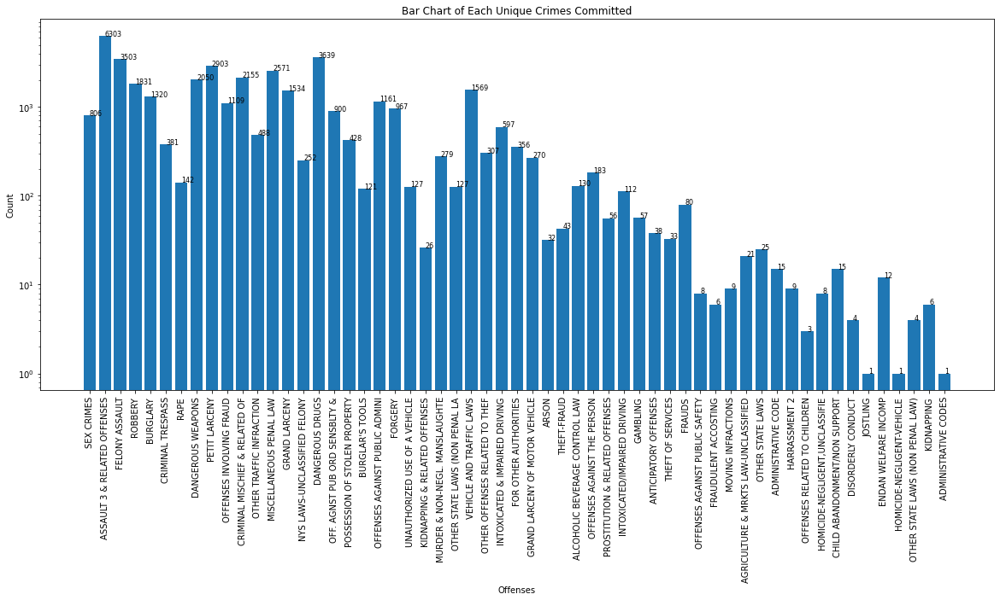

In [17]:
import matplotlib.pyplot as plt
plt.figure(figsize=(20,8))
plt.xticks(rotation=90)
for i in range(len(offence_counts)):
    plt.text(x = offenses[i], y = offence_counts[i], s = offence_counts[i], size = 8)
plt.yscale("log")
plt.bar(offenses, offence_counts)
plt.xlabel("Offenses")
plt.ylabel("Count")
plt.title("Bar Chart of Each Unique Crimes Committed")
plt.show()


In [18]:
gender_arst_df = arst_df.groupby(["perp_sex"]).count()

In [19]:
gender_arst_df

,arrest_date,pd_desc,ofns_desc,arrest_boro,arrest_precinct,age_group,perp_race,x_coord_cd,y_coord_cd,latitude,longitude,violence_level
perp_sex,,,,,,,,,,,,
F,6331,6331,6331,6331,6331,6331,6331,6331,6331,6331,6331,6331
M,32803,32803,32803,32803,32803,32803,32803,32803,32803,32803,32803,32803


Text(0.5, 1.0, 'Bar Chart of Crimes Committed by Gender')

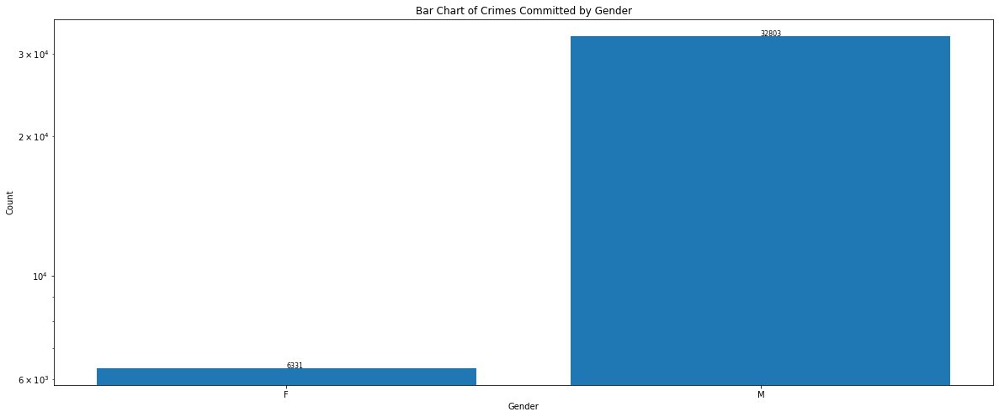

In [20]:
import numpy as np

plt.figure(figsize=(20,8))

gender_grps = np.array(gender_arst_df.index)

for i in range(len(gender_arst_df["arrest_date"].values)):
    plt.text(x = gender_grps[i], y = gender_arst_df["arrest_date"].values[i], s = gender_arst_df["arrest_date"].values[i], size = 8)
plt.yscale("log")
plt.bar(gender_grps, gender_arst_df["arrest_date"].values)
plt.xlabel("Gender")
plt.ylabel("Count")
plt.title("Bar Chart of Crimes Committed by Gender")

In [21]:
age_grp_df = arst_df.groupby(["age_group"]).count()

In [22]:
age_grp_df

,arrest_date,pd_desc,ofns_desc,arrest_boro,arrest_precinct,perp_sex,perp_race,x_coord_cd,y_coord_cd,latitude,longitude,violence_level
age_group,,,,,,,,,,,,
18-24,7738,7738,7738,7738,7738,7738,7738,7738,7738,7738,7738,7738
25-44,22309,22309,22309,22309,22309,22309,22309,22309,22309,22309,22309,22309
45-64,7349,7349,7349,7349,7349,7349,7349,7349,7349,7349,7349,7349
65+,538,538,538,538,538,538,538,538,538,538,538,538
<18,1200,1200,1200,1200,1200,1200,1200,1200,1200,1200,1200,1200


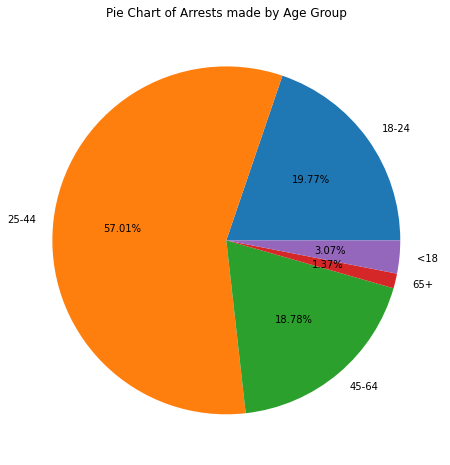

In [23]:
plt.figure(figsize=(20,8))

age_grps = np.array(age_grp_df.index)
plt.pie(age_grp_df["arrest_date"].values, labels = age_grps, autopct='%1.2f%%')
plt.title("Pie Chart of Arrests made by Age Group")
plt.show()

Text(0.5, 1.0, 'Bar Chart of Crimes Committed by Age Groups')

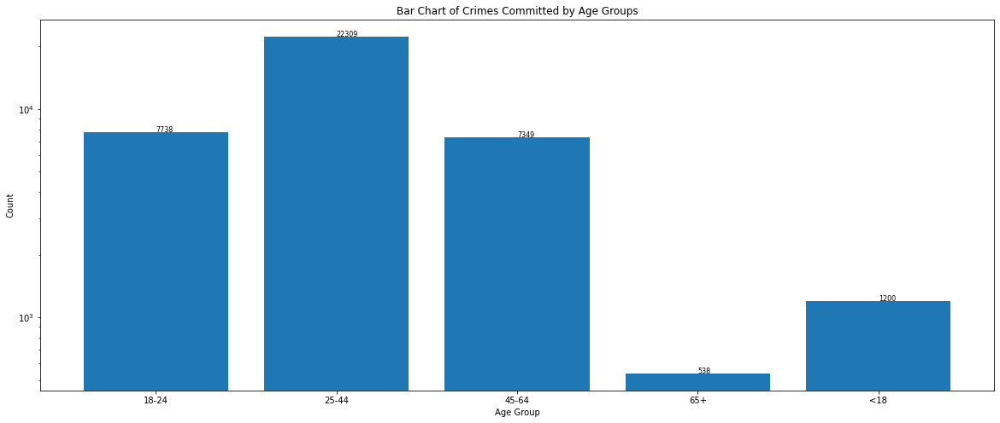

In [24]:
plt.figure(figsize=(20,8))

for i in range(len(age_grp_df["arrest_date"].values)):
    plt.text(x = age_grps[i], y = age_grp_df["arrest_date"].values[i], s = age_grp_df["arrest_date"].values[i], size = 8)
plt.yscale("log")
plt.bar(age_grps, age_grp_df["arrest_date"].values)
plt.xlabel("Age Group")
plt.ylabel("Count")
plt.title("Bar Chart of Crimes Committed by Age Groups")

In [25]:
arst_boro = arst_df.groupby(["arrest_boro"]).count()
arst_boro

,arrest_date,pd_desc,ofns_desc,arrest_precinct,age_group,perp_sex,perp_race,x_coord_cd,y_coord_cd,latitude,longitude,violence_level
arrest_boro,,,,,,,,,,,,
B,8840,8840,8840,8840,8840,8840,8840,8840,8840,8840,8840,8840
K,10743,10743,10743,10743,10743,10743,10743,10743,10743,10743,10743,10743
M,9467,9467,9467,9467,9467,9467,9467,9467,9467,9467,9467,9467
Q,8209,8209,8209,8209,8209,8209,8209,8209,8209,8209,8209,8209
S,1875,1875,1875,1875,1875,1875,1875,1875,1875,1875,1875,1875


Text(0.5, 1.0, 'Bar Chart of Crimes Committed in Each Borough')

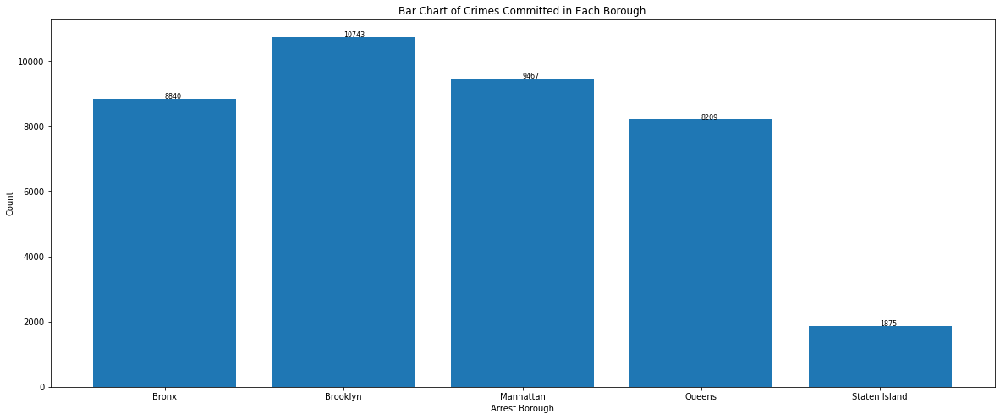

In [26]:
plt.figure(figsize=(20,8))

boro = np.array(arst_boro.index)
boro_dict = {'B':"Bronx", "K":"Brooklyn","M":"Manhattan","Q":"Queens","S":"Staten Island"}

boro_names = list(boro_dict.values())

for i in range(len(arst_boro["arrest_date"].values)):
    plt.text(x = boro_names[i], y = arst_boro["arrest_date"].values[i], s = arst_boro["arrest_date"].values[i], size = 8)

plt.bar(boro_dict.values(), arst_boro["arrest_date"].values)
plt.xlabel("Arrest Borough")
plt.ylabel("Count")
plt.title("Bar Chart of Crimes Committed in Each Borough")

In [27]:
arst_precinct_df = arst_df.groupby(["arrest_precinct"]).count()
arst_precinct_df

,arrest_date,pd_desc,ofns_desc,arrest_boro,age_group,perp_sex,perp_race,x_coord_cd,y_coord_cd,latitude,longitude,violence_level
arrest_precinct,,,,,,,,,,,,
1,342,342,342,342,342,342,342,342,342,342,342,342
10,352,352,352,352,352,352,352,352,352,352,352,352
100,222,222,222,222,222,222,222,222,222,222,222,222
101,377,377,377,377,377,377,377,377,377,377,377,377
102,491,491,491,491,491,491,491,491,491,491,491,491
...,...,...,...,...,...,...,...,...,...,...,...,...
84,494,494,494,494,494,494,494,494,494,494,494,494
88,215,215,215,215,215,215,215,215,215,215,215,215
9,352,352,352,352,352,352,352,352,352,352,352,352


Text(0.5, 1.0, 'Bar Chart of Crimes Committed by Precinct')

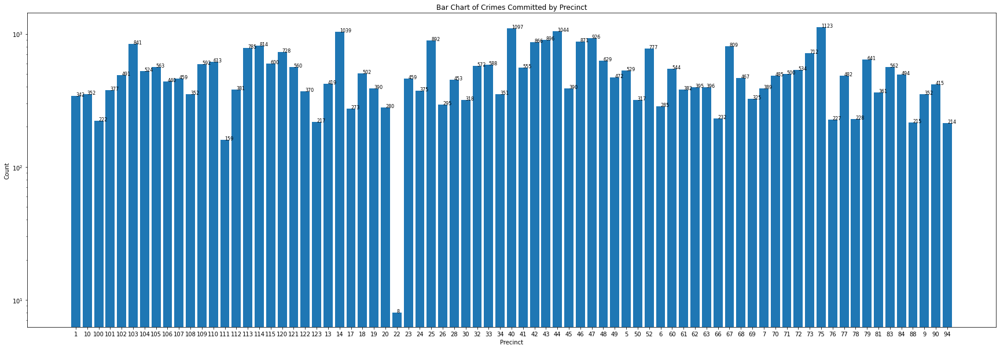

In [28]:
plt.figure(figsize=(30,10))

precinct_grps = np.array(arst_precinct_df.index)

for i in range(len(arst_precinct_df["arrest_date"].values)):
    plt.text(x = precinct_grps[i], y = arst_precinct_df["arrest_date"].values[i], s = arst_precinct_df["arrest_date"].values[i], size = 8)
plt.yscale("log")
plt.bar(precinct_grps, arst_precinct_df["arrest_date"].values)
plt.xlabel("Precinct")
plt.ylabel("Count")
plt.title("Bar Chart of Crimes Committed by Precinct")

In [29]:
arst_race = arst_df.groupby(["perp_race"]).count()
arst_race

,arrest_date,pd_desc,ofns_desc,arrest_boro,arrest_precinct,age_group,perp_sex,x_coord_cd,y_coord_cd,latitude,longitude,violence_level
perp_race,,,,,,,,,,,,
AMERICAN INDIAN/ALASKAN NATIVE,99,99,99,99,99,99,99,99,99,99,99,99
ASIAN / PACIFIC ISLANDER,1986,1986,1986,1986,1986,1986,1986,1986,1986,1986,1986,1986
BLACK,19636,19636,19636,19636,19636,19636,19636,19636,19636,19636,19636,19636
BLACK HISPANIC,3387,3387,3387,3387,3387,3387,3387,3387,3387,3387,3387,3387
UNKNOWN,145,145,145,145,145,145,145,145,145,145,145,145
WHITE,4147,4147,4147,4147,4147,4147,4147,4147,4147,4147,4147,4147
WHITE HISPANIC,9734,9734,9734,9734,9734,9734,9734,9734,9734,9734,9734,9734


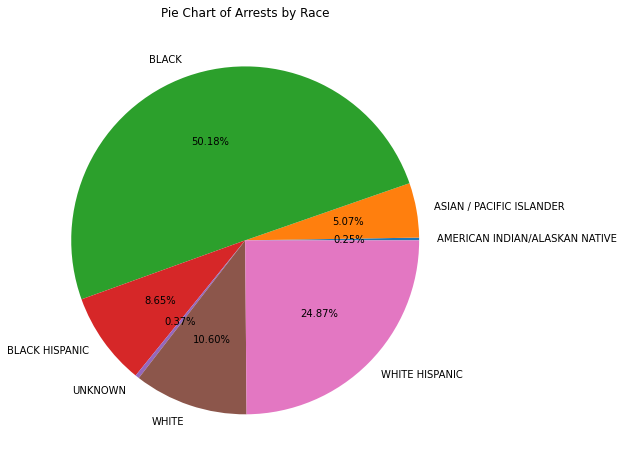

In [30]:
plt.figure(figsize=(20,8))

arst_race_grp = np.array(arst_race.index)
plt.pie(arst_race["arrest_date"].values, labels = arst_race_grp, autopct='%1.2f%%')
plt.title("Pie Chart of Arrests by Race")
plt.show()

Text(0.5, 1.0, 'Bar Chart of Arrests by Race')

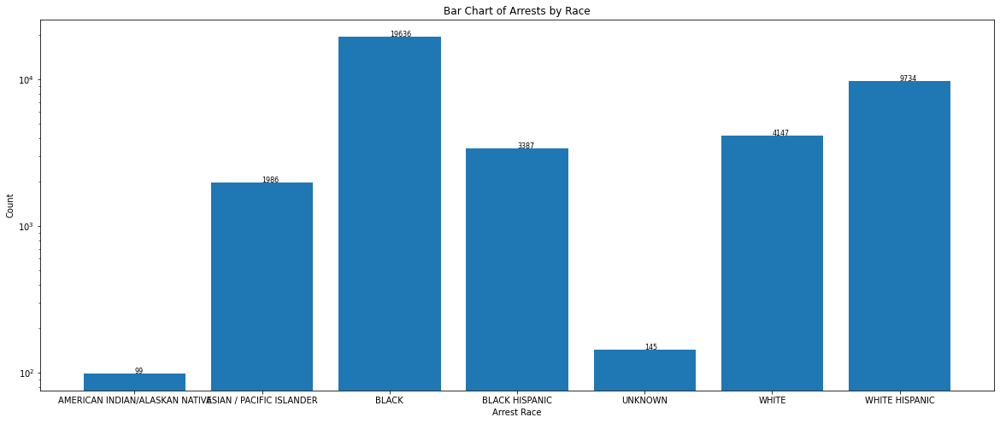

In [31]:
plt.figure(figsize=(20,8))

for i in range(len(arst_race["arrest_date"].values)):
    plt.text(x = arst_race_grp[i], y = arst_race["arrest_date"].values[i], s = arst_race["arrest_date"].values[i], size = 8)
plt.yscale("log")
plt.bar(arst_race_grp, arst_race["arrest_date"].values)
plt.xlabel("Arrest Race")
plt.ylabel("Count")
plt.title("Bar Chart of Arrests by Race")

In [32]:
some_df = arst_df.groupby(["arrest_boro", "ofns_desc"])

In [33]:
new_df = arst_df.groupby(["ofns_desc", "arrest_boro"])
new_df

In [34]:
boroughs = list(arst_df["arrest_boro"].unique())

In [35]:
for offense in offenses:
  for borough in boroughs:
    print(offense)
    print(borough)
    try:
      print(new_df.get_group((offense, borough)).count())
    except:
      break

SEX CRIMES
M
arrest_date        156
pd_desc            156
ofns_desc          156
arrest_boro        156
arrest_precinct    156
age_group          156
perp_sex           156
perp_race          156
x_coord_cd         156
y_coord_cd         156
latitude           156
longitude          156
violence_level     156
dtype: int64
SEX CRIMES
K
arrest_date        201
pd_desc            201
ofns_desc          201
arrest_boro        201
arrest_precinct    201
age_group          201
perp_sex           201
perp_race          201
x_coord_cd         201
y_coord_cd         201
latitude           201
longitude          201
violence_level     201
dtype: int64
SEX CRIMES
B
arrest_date        182
pd_desc            182
ofns_desc          182
arrest_boro        182
arrest_precinct    182
age_group          182
perp_sex           182
perp_race          182
x_coord_cd         182
y_coord_cd         182
latitude           182
longitude          182
violence_level     182
dtype: int64
SEX CRIMES
S
arrest_date 

In [36]:
#dependent variables: "Violent", "not so violent", "medium violence"

lv_offenses= ["ROBBERY","OFF. AGNST PUB ORD SENSBLTY &",'PETIT LARCENY','GRAND LARCENY',
                                       "UNAUTHORIZED USE OF A VEHICLE", "OFFENSES INVOLVING FRAUD", 
                                       "CRIMINAL MISCHIEF & RELATED OF", 'POSSESSION OF STOLEN PROPERTY','OFFENSES AGAINST THE PERSON',
                                       'FORGERY',  'CRIMINAL TRESPASS', "BURGLAR'S TOOLS",
                                       'GRAND LARCENY OF MOTOR VEHICLE',
                                       'PROSTITUTION & RELATED OFFENSES','FOR OTHER AUTHORITIES', 'VEHICLE AND TRAFFIC LAWS','ANTICIPATORY OFFENSES',
                                       'GAMBLING','OTHER TRAFFIC INFRACTION',  'THEFT OF SERVICES','FRAUDS','THEFT-FRAUD',
                                       'MOVING INFRACTIONS', 'ALCOHOLIC BEVERAGE CONTROL LAW','OTHER STATE LAWS',
                                       'ADMINISTRATIVE CODES',
                                       'AGRICULTURE & MRKTS LAW-UNCLASSIFIED', 'INTOXICATED/IMPAIRED DRIVING','ADMINISTRATIVE CODE',
                                       'JOSTLING','CHILD ABANDONMENT/NON SUPPORT','HARRASSMENT 2', 'DISORDERLY CONDUCT',
                                       'ENDAN WELFARE INCOMP','FRAUDULENT ACCOSTING','ESCAPE 3','LOITERING/GAMBLING (CARDS, DIC',
                                       'NEW YORK CITY HEALTH CODE','MISCELLANEOUS PENAL LAW']


medium_violent= ['BURGLARY', 'DANGEROUS DRUGS', 'OTHER STATE LAWS (NON PENAL LA', 'INTOXICATED & IMPAIRED DRIVING', 
                 'SEX CRIMES', 'OFFENSES AGAINST PUBLIC ADMINI', 'OTHER OFFENSES RELATED TO THEF', 'ARSON', 'OTHER STATE LAWS (NON PENAL LAW)']

most_violent= ['RAPE', 'ASSAULT 3 & RELATED OFFENSES', 'DANGEROUS WEAPONS', 'FELONY ASSAULT', 'MURDER & NON-NEGL. MANSLAUGHTE',
               'KIDNAPPING & RELATED OFFENSES', 'NYS LAWS-UNCLASSIFIED FELONY','HOMICIDE-NEGLIGENT,UNCLASSIFIE','OFFENSES AGAINST PUBLIC SAFETY',
               'OFFENSES RELATED TO CHILDREN','KIDNAPPING AND RELATED OFFENSES','HOMICIDE-NEGLIGENT-VEHICLE','KIDNAPPING']

#'OTHER STATE LAWS (NON PENAL LAW', 'DISORDERLY CONDUCT','ENDAN WELFARE INCOMP'

for i in lv_offenses:
  arst_df = arst_df.replace({'violence_level':{i:"Least Violent"}})

for j in medium_violent:
  arst_df = arst_df.replace({'violence_level':{j:"Medium Violent"}})

for k in most_violent:
  arst_df = arst_df.replace({'violence_level':{k:"Most Violent"}})

arst_df.head(20)


,arrest_date,pd_desc,ofns_desc,arrest_boro,arrest_precinct,age_group,perp_sex,perp_race,x_coord_cd,y_coord_cd,latitude,longitude,violence_level
0,2021-03-26T00:00:00.000,SEXUAL ABUSE,SEX CRIMES,M,5,25-44,M,WHITE,984946,200203,40.716195914000025,-73.99749074599998,Medium Violent
1,2021-03-25T00:00:00.000,ASSAULT 3,ASSAULT 3 & RELATED OFFENSES,K,84,18-24,M,BLACK,987792,190460,40.689452980000056,-73.98722940999993,Most Violent
2,2021-03-18T00:00:00.000,ASSAULT 3,ASSAULT 3 & RELATED OFFENSES,B,48,18-24,M,BLACK,1011811,246833,40.844139945000045,-73.90038861799998,Most Violent
3,2021-03-17T00:00:00.000,STRANGULATION 1ST,FELONY ASSAULT,K,79,25-44,M,WHITE,1000272,187022,40.68000266400003,-73.942236182,Most Violent
4,2021-03-14T00:00:00.000,STRANGULATION 1ST,FELONY ASSAULT,B,49,25-44,M,BLACK,1021639,250223,40.85340834100003,-73.86484873899997,Most Violent
5,2021-03-05T00:00:00.000,"ROBBERY,OPEN AREA UNCLASSIFIED",ROBBERY,B,47,18-24,M,BLACK,1026486,262591,40.88733281800006,-73.84725001299995,Least Violent
6,2021-03-05T00:00:00.000,"BURGLARY,UNCLASSIFIED,UNKNOWN",BURGLARY,K,90,25-44,M,BLACK,998016,196598,40.70629036500002,-73.95035033099998,Medium Violent
7,2021-03-05T00:00:00.000,"ROBBERY,OPEN AREA UNCLASSIFIED",ROBBERY,M,18,25-44,M,BLACK,988248,215413,40.75794273400004,-73.98557030899997,Least Violent
8,2021-03-04T00:00:00.000,"TRESPASS 2, CRIMINAL",CRIMINAL TRESPASS,M,26,45-64,M,BLACK,997129,237012,40.817217733000064,-73.95347213499997,Least Violent
9,2021-03-03T00:00:00.000,RAPE 1,RAPE,B,52,25-44,M,BLACK,1017542,255919,40.86905853200005,-73.87963014799993,Most Violent


In [37]:
arst_df.isnull().sum()

arrest_date        0
pd_desc            0
ofns_desc          0
arrest_boro        0
arrest_precinct    0
age_group          0
perp_sex           0
perp_race          0
x_coord_cd         0
y_coord_cd         0
latitude           0
longitude          0
violence_level     0
dtype: int64

In [38]:
arst_df["violence_level"].unique()

array(['Medium Violent', 'Most Violent', 'Least Violent'], dtype=object)

In [39]:
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster

nyc_coords = (40.767937,-73.982155)

mep = folium.Map(location=nyc_coords, zoom_start=10)

incidents=MarkerCluster().add_to(mep)

#Showing how 20000 crimes are clustered in NYC
for arst in arst_df.iloc[:20000].iterrows():
  folium.Marker(location = [float(arst[1][10]), float(arst[1][11])], popup=arst[1][2]).add_to(incidents)

mep

In [40]:
import folium

nyc_coords = (40.767937,-73.982155)

map = folium.Map(location=nyc_coords, zoom_start=10)

data_heatmap = arst_df.dropna(axis=0, subset=['latitude','longitude'])
data_heatmap = [[float(row['latitude']),float(row['longitude'])] for index, row in data_heatmap.iterrows()]
HeatMap(data_heatmap, radius=10).add_to(map)

map

In [41]:
arst_df.head()

,arrest_date,pd_desc,ofns_desc,arrest_boro,arrest_precinct,age_group,perp_sex,perp_race,x_coord_cd,y_coord_cd,latitude,longitude,violence_level
0,2021-03-26T00:00:00.000,SEXUAL ABUSE,SEX CRIMES,M,5,25-44,M,WHITE,984946,200203,40.716195914000025,-73.99749074599998,Medium Violent
1,2021-03-25T00:00:00.000,ASSAULT 3,ASSAULT 3 & RELATED OFFENSES,K,84,18-24,M,BLACK,987792,190460,40.689452980000056,-73.98722940999993,Most Violent
2,2021-03-18T00:00:00.000,ASSAULT 3,ASSAULT 3 & RELATED OFFENSES,B,48,18-24,M,BLACK,1011811,246833,40.844139945000045,-73.90038861799998,Most Violent
3,2021-03-17T00:00:00.000,STRANGULATION 1ST,FELONY ASSAULT,K,79,25-44,M,WHITE,1000272,187022,40.68000266400003,-73.942236182,Most Violent
4,2021-03-14T00:00:00.000,STRANGULATION 1ST,FELONY ASSAULT,B,49,25-44,M,BLACK,1021639,250223,40.85340834100003,-73.86484873899997,Most Violent


In [42]:
algo_df = arst_df.drop(['arrest_date', 'x_coord_cd', 'y_coord_cd', 'latitude', 'longitude'], axis=1)

In [43]:
algo_df.head(10)

,pd_desc,ofns_desc,arrest_boro,arrest_precinct,age_group,perp_sex,perp_race,violence_level
0,SEXUAL ABUSE,SEX CRIMES,M,5,25-44,M,WHITE,Medium Violent
1,ASSAULT 3,ASSAULT 3 & RELATED OFFENSES,K,84,18-24,M,BLACK,Most Violent
2,ASSAULT 3,ASSAULT 3 & RELATED OFFENSES,B,48,18-24,M,BLACK,Most Violent
3,STRANGULATION 1ST,FELONY ASSAULT,K,79,25-44,M,WHITE,Most Violent
4,STRANGULATION 1ST,FELONY ASSAULT,B,49,25-44,M,BLACK,Most Violent
5,"ROBBERY,OPEN AREA UNCLASSIFIED",ROBBERY,B,47,18-24,M,BLACK,Least Violent
6,"BURGLARY,UNCLASSIFIED,UNKNOWN",BURGLARY,K,90,25-44,M,BLACK,Medium Violent
7,"ROBBERY,OPEN AREA UNCLASSIFIED",ROBBERY,M,18,25-44,M,BLACK,Least Violent
8,"TRESPASS 2, CRIMINAL",CRIMINAL TRESPASS,M,26,45-64,M,BLACK,Least Violent
9,RAPE 1,RAPE,B,52,25-44,M,BLACK,Most Violent


In [44]:
algo_df['arrest_precinct'] = algo_df['arrest_precinct'].apply(lambda x: str(x) + 'th Precinct')
algo_df.head(10)

,pd_desc,ofns_desc,arrest_boro,arrest_precinct,age_group,perp_sex,perp_race,violence_level
0,SEXUAL ABUSE,SEX CRIMES,M,5th Precinct,25-44,M,WHITE,Medium Violent
1,ASSAULT 3,ASSAULT 3 & RELATED OFFENSES,K,84th Precinct,18-24,M,BLACK,Most Violent
2,ASSAULT 3,ASSAULT 3 & RELATED OFFENSES,B,48th Precinct,18-24,M,BLACK,Most Violent
3,STRANGULATION 1ST,FELONY ASSAULT,K,79th Precinct,25-44,M,WHITE,Most Violent
4,STRANGULATION 1ST,FELONY ASSAULT,B,49th Precinct,25-44,M,BLACK,Most Violent
5,"ROBBERY,OPEN AREA UNCLASSIFIED",ROBBERY,B,47th Precinct,18-24,M,BLACK,Least Violent
6,"BURGLARY,UNCLASSIFIED,UNKNOWN",BURGLARY,K,90th Precinct,25-44,M,BLACK,Medium Violent
7,"ROBBERY,OPEN AREA UNCLASSIFIED",ROBBERY,M,18th Precinct,25-44,M,BLACK,Least Violent
8,"TRESPASS 2, CRIMINAL",CRIMINAL TRESPASS,M,26th Precinct,45-64,M,BLACK,Least Violent
9,RAPE 1,RAPE,B,52th Precinct,25-44,M,BLACK,Most Violent


In [45]:
x_for_arst_boro = algo_df.drop(["arrest_boro"], axis=1)

boro_df = pd.get_dummies(algo_df, columns = x_for_arst_boro.columns)

boro_df.head()

,arrest_boro,"pd_desc_ACCOSTING,FRAUDULENT","pd_desc_ADM.CODE,UNCLASSIFIED VIOLATIO",pd_desc_AGGRAVATED CRIMINAL CONTEMPT,pd_desc_AGGRAVATED GRAND LARCENY OF ATM,pd_desc_AGGRAVATED HARASSMENT 1,pd_desc_AGGRAVATED HARASSMENT 2,pd_desc_AGGRAVATED SEXUAL ASBUSE,pd_desc_ALCOHOLIC BEVERAGE CONTROL LAW,"pd_desc_ALCOHOLIC BEVERAGES,PUBLIC CON",pd_desc_ARSON 1,"pd_desc_ARSON 2,3,4","pd_desc_ASSAULT 2,1,UNCLASSIFIED",pd_desc_ASSAULT 3,pd_desc_ASSAULT POLICE/PEACE OFFICER,"pd_desc_ASSEMBLY,UNLAWFUL",pd_desc_BAIL JUMPING 1 & 2,pd_desc_BAIL JUMPING 3,"pd_desc_BRIBERY,COMMERCIAL","pd_desc_BRIBERY,PUBLIC ADMINISTRATION","pd_desc_BURGLARS TOOLS,UNCLASSIFIED","pd_desc_BURGLARY,RESIDENCE,NIGHT","pd_desc_BURGLARY,UNCLASSIFIED,UNKNOWN",pd_desc_CAUSE SPI/KILL ANIMAL,pd_desc_CHILD ABANDONMENT,"pd_desc_CHILD, ENDANGERING WELFARE","pd_desc_CHILD,LICENSED PREMISES","pd_desc_CHILD,OFFENSES AGAINST,UNCLASS",pd_desc_COERCION 1,pd_desc_COERCION 2,"pd_desc_CONSPIRACY 2, 1","pd_desc_CONSPIRACY 4, 3","pd_desc_CONTEMPT,CRIMINAL","pd_desc_CONTROLLED SUBSTANCE, INTENT T","pd_desc_CONTROLLED SUBSTANCE, POSSESSI","pd_desc_CONTROLLED SUBSTANCE, SALE 4","pd_desc_CONTROLLED SUBSTANCE, SALE 5","pd_desc_CONTROLLED SUBSTANCE,INTENT TO","pd_desc_CONTROLLED SUBSTANCE,POSSESS.","pd_desc_CONTROLLED SUBSTANCE,SALE 1",...,arrest_precinct_63th Precinct,arrest_precinct_66th Precinct,arrest_precinct_67th Precinct,arrest_precinct_68th Precinct,arrest_precinct_69th Precinct,arrest_precinct_6th Precinct,arrest_precinct_70th Precinct,arrest_precinct_71th Precinct,arrest_precinct_72th Precinct,arrest_precinct_73th Precinct,arrest_precinct_75th Precinct,arrest_precinct_76th Precinct,arrest_precinct_77th Precinct,arrest_precinct_78th Precinct,arrest_precinct_79th Precinct,arrest_precinct_7th Precinct,arrest_precinct_81th Precinct,arrest_precinct_83th Precinct,arrest_precinct_84th Precinct,arrest_precinct_88th Precinct,arrest_precinct_90th Precinct,arrest_precinct_94th Precinct,arrest_precinct_9th Precinct,age_group_18-24,age_group_25-44,age_group_45-64,age_group_65+,age_group_<18,perp_sex_F,perp_sex_M,perp_race_AMERICAN INDIAN/ALASKAN NATIVE,perp_race_ASIAN / PACIFIC ISLANDER,perp_race_BLACK,perp_race_BLACK HISPANIC,perp_race_UNKNOWN,perp_race_WHITE,perp_race_WHITE HISPANIC,violence_level_Least Violent,violence_level_Medium Violent,violence_level_Most Violent
0,M,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0
1,K,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1
2,B,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1
3,K,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1
4,B,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1


In [46]:
boro_df_cols = list(boro_df.columns)
boro_df_cols

['arrest_boro',
 'pd_desc_ACCOSTING,FRAUDULENT',
 'pd_desc_ADM.CODE,UNCLASSIFIED VIOLATIO',
 'pd_desc_AGGRAVATED CRIMINAL CONTEMPT',
 'pd_desc_AGGRAVATED GRAND LARCENY OF ATM',
 'pd_desc_AGGRAVATED HARASSMENT 1',
 'pd_desc_AGGRAVATED HARASSMENT 2',
 'pd_desc_AGGRAVATED SEXUAL ASBUSE',
 'pd_desc_ALCOHOLIC BEVERAGE CONTROL LAW',
 'pd_desc_ALCOHOLIC BEVERAGES,PUBLIC CON',
 'pd_desc_ARSON 1',
 'pd_desc_ARSON 2,3,4',
 'pd_desc_ASSAULT 2,1,UNCLASSIFIED',
 'pd_desc_ASSAULT 3',
 'pd_desc_ASSAULT POLICE/PEACE OFFICER',
 'pd_desc_ASSEMBLY,UNLAWFUL',
 'pd_desc_BAIL JUMPING 1 & 2',
 'pd_desc_BAIL JUMPING 3',
 'pd_desc_BRIBERY,COMMERCIAL',
 'pd_desc_BRIBERY,PUBLIC ADMINISTRATION',
 'pd_desc_BURGLARS TOOLS,UNCLASSIFIED',
 'pd_desc_BURGLARY,RESIDENCE,NIGHT',
 'pd_desc_BURGLARY,UNCLASSIFIED,UNKNOWN',
 'pd_desc_CAUSE SPI/KILL ANIMAL',
 'pd_desc_CHILD ABANDONMENT',
 'pd_desc_CHILD, ENDANGERING WELFARE',
 'pd_desc_CHILD,LICENSED PREMISES',
 'pd_desc_CHILD,OFFENSES AGAINST,UNCLASS',
 'pd_desc_COERCION 1',

In [47]:
#drop these columns to avoid dummy variable trap
boro_df = boro_df.drop(['pd_desc_WEAPONS, POSSESSION, ETC','ofns_desc_VEHICLE AND TRAFFIC LAWS', 'arrest_precinct_9th Precinct', 'age_group_<18', 'perp_sex_M', 'perp_race_UNKNOWN', 'violence_level_Most Violent'], axis=1)

In [48]:
x_for_arst_precinct = algo_df.drop(["arrest_precinct"], axis=1)

precinct_df = pd.get_dummies(algo_df, columns = x_for_arst_precinct.columns)

precinct_df.head()

,arrest_precinct,"pd_desc_ACCOSTING,FRAUDULENT","pd_desc_ADM.CODE,UNCLASSIFIED VIOLATIO",pd_desc_AGGRAVATED CRIMINAL CONTEMPT,pd_desc_AGGRAVATED GRAND LARCENY OF ATM,pd_desc_AGGRAVATED HARASSMENT 1,pd_desc_AGGRAVATED HARASSMENT 2,pd_desc_AGGRAVATED SEXUAL ASBUSE,pd_desc_ALCOHOLIC BEVERAGE CONTROL LAW,"pd_desc_ALCOHOLIC BEVERAGES,PUBLIC CON",pd_desc_ARSON 1,"pd_desc_ARSON 2,3,4","pd_desc_ASSAULT 2,1,UNCLASSIFIED",pd_desc_ASSAULT 3,pd_desc_ASSAULT POLICE/PEACE OFFICER,"pd_desc_ASSEMBLY,UNLAWFUL",pd_desc_BAIL JUMPING 1 & 2,pd_desc_BAIL JUMPING 3,"pd_desc_BRIBERY,COMMERCIAL","pd_desc_BRIBERY,PUBLIC ADMINISTRATION","pd_desc_BURGLARS TOOLS,UNCLASSIFIED","pd_desc_BURGLARY,RESIDENCE,NIGHT","pd_desc_BURGLARY,UNCLASSIFIED,UNKNOWN",pd_desc_CAUSE SPI/KILL ANIMAL,pd_desc_CHILD ABANDONMENT,"pd_desc_CHILD, ENDANGERING WELFARE","pd_desc_CHILD,LICENSED PREMISES","pd_desc_CHILD,OFFENSES AGAINST,UNCLASS",pd_desc_COERCION 1,pd_desc_COERCION 2,"pd_desc_CONSPIRACY 2, 1","pd_desc_CONSPIRACY 4, 3","pd_desc_CONTEMPT,CRIMINAL","pd_desc_CONTROLLED SUBSTANCE, INTENT T","pd_desc_CONTROLLED SUBSTANCE, POSSESSI","pd_desc_CONTROLLED SUBSTANCE, SALE 4","pd_desc_CONTROLLED SUBSTANCE, SALE 5","pd_desc_CONTROLLED SUBSTANCE,INTENT TO","pd_desc_CONTROLLED SUBSTANCE,POSSESS.","pd_desc_CONTROLLED SUBSTANCE,SALE 1",...,ofns_desc_OFFENSES AGAINST THE PERSON,ofns_desc_OFFENSES INVOLVING FRAUD,ofns_desc_OFFENSES RELATED TO CHILDREN,ofns_desc_OTHER OFFENSES RELATED TO THEF,ofns_desc_OTHER STATE LAWS,ofns_desc_OTHER STATE LAWS (NON PENAL LA,ofns_desc_OTHER STATE LAWS (NON PENAL LAW),ofns_desc_OTHER TRAFFIC INFRACTION,ofns_desc_PETIT LARCENY,ofns_desc_POSSESSION OF STOLEN PROPERTY,ofns_desc_PROSTITUTION & RELATED OFFENSES,ofns_desc_RAPE,ofns_desc_ROBBERY,ofns_desc_SEX CRIMES,ofns_desc_THEFT OF SERVICES,ofns_desc_THEFT-FRAUD,ofns_desc_UNAUTHORIZED USE OF A VEHICLE,ofns_desc_VEHICLE AND TRAFFIC LAWS,arrest_boro_B,arrest_boro_K,arrest_boro_M,arrest_boro_Q,arrest_boro_S,age_group_18-24,age_group_25-44,age_group_45-64,age_group_65+,age_group_<18,perp_sex_F,perp_sex_M,perp_race_AMERICAN INDIAN/ALASKAN NATIVE,perp_race_ASIAN / PACIFIC ISLANDER,perp_race_BLACK,perp_race_BLACK HISPANIC,perp_race_UNKNOWN,perp_race_WHITE,perp_race_WHITE HISPANIC,violence_level_Least Violent,violence_level_Medium Violent,violence_level_Most Violent
0,5th Precinct,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0
1,84th Precinct,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1
2,48th Precinct,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1
3,79th Precinct,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,1,0,0,0,1
4,49th Precinct,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1


In [49]:
list(precinct_df.columns)

['arrest_precinct',
 'pd_desc_ACCOSTING,FRAUDULENT',
 'pd_desc_ADM.CODE,UNCLASSIFIED VIOLATIO',
 'pd_desc_AGGRAVATED CRIMINAL CONTEMPT',
 'pd_desc_AGGRAVATED GRAND LARCENY OF ATM',
 'pd_desc_AGGRAVATED HARASSMENT 1',
 'pd_desc_AGGRAVATED HARASSMENT 2',
 'pd_desc_AGGRAVATED SEXUAL ASBUSE',
 'pd_desc_ALCOHOLIC BEVERAGE CONTROL LAW',
 'pd_desc_ALCOHOLIC BEVERAGES,PUBLIC CON',
 'pd_desc_ARSON 1',
 'pd_desc_ARSON 2,3,4',
 'pd_desc_ASSAULT 2,1,UNCLASSIFIED',
 'pd_desc_ASSAULT 3',
 'pd_desc_ASSAULT POLICE/PEACE OFFICER',
 'pd_desc_ASSEMBLY,UNLAWFUL',
 'pd_desc_BAIL JUMPING 1 & 2',
 'pd_desc_BAIL JUMPING 3',
 'pd_desc_BRIBERY,COMMERCIAL',
 'pd_desc_BRIBERY,PUBLIC ADMINISTRATION',
 'pd_desc_BURGLARS TOOLS,UNCLASSIFIED',
 'pd_desc_BURGLARY,RESIDENCE,NIGHT',
 'pd_desc_BURGLARY,UNCLASSIFIED,UNKNOWN',
 'pd_desc_CAUSE SPI/KILL ANIMAL',
 'pd_desc_CHILD ABANDONMENT',
 'pd_desc_CHILD, ENDANGERING WELFARE',
 'pd_desc_CHILD,LICENSED PREMISES',
 'pd_desc_CHILD,OFFENSES AGAINST,UNCLASS',
 'pd_desc_COERCION

In [50]:
#drop columns to avoid dummy variable trap
precinct_df = precinct_df.drop(['pd_desc_WEAPONS, POSSESSION, ETC','ofns_desc_VEHICLE AND TRAFFIC LAWS', 'arrest_boro_S', 'age_group_<18', 'perp_sex_M', 'perp_race_UNKNOWN', 'violence_level_Most Violent'], axis=1)

In [51]:
from sklearn.model_selection import train_test_split
#train test and split the data
#arrest boro
x1 = boro_df.drop(["arrest_boro"], axis=1)
y1 = boro_df[["arrest_boro"]]
#y1 = algo_df[['arrest_boro']]

#arrest precinct
x2 = precinct_df.drop(["arrest_precinct"], axis=1)
y2 = precinct_df[['arrest_precinct']]

#Splitting data for x1 and y1 (arrest boro)
X1_train, X1_test, y1_train, y1_test = train_test_split(x1, y1, test_size=0.3, random_state=42)
#Splitting data for x2 and y2 (arrest precinct)
X2_train, X2_test, y2_train, y2_test = train_test_split(x2, y2, test_size=0.3, random_state=42)

In [52]:
#Random Forest - Siddesh Gannu

#predict the arrest boro
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn import metrics

random_forest_boro = RandomForestClassifier(n_estimators = 10, max_depth=30, bootstrap=True)
rfb = random_forest_boro.fit(X1_train, y1_train)
y_pred_boro = random_forest_boro.predict(X1_test)

print("Score: ", random_forest_boro.score(X1_train, y1_train))
print("Accuracy score: ", accuracy_score(y1_test, y_pred_boro))

print(classification_report(y1_test, y_pred_boro, digits=10))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:10: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  # Remove the CWD from sys.path while we load stuff.


Score:  0.9653926185521848
Accuracy score:  0.9630355165658803
              precision    recall  f1-score   support

           B  1.0000000000 0.9600150886 0.9795996921      2651
           K  0.9680781759 0.9307860946 0.9490659428      3193
           M  0.8925699582 0.9809119830 0.9346581341      2829
           Q  0.9991833401 0.9788000000 0.9888866438      2500
           S  1.0000000000 1.0000000000 1.0000000000       568

    accuracy                      0.9630355166     11741
   macro avg  0.9719662948 0.9701026333 0.9704420825     11741
weighted avg  0.9652595501 0.9630355166 0.9634316336     11741



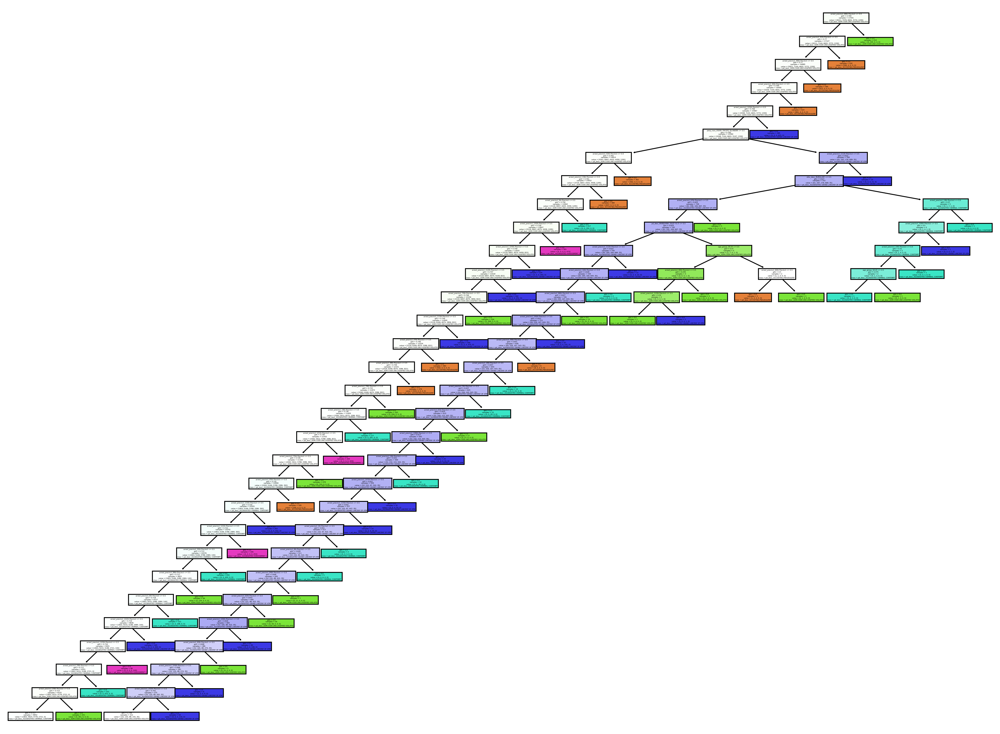

In [53]:
#random forest for 5 estimators (arrest boro)
from sklearn import tree

fn1=X1_train.columns
cn1=X1_test.columns
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(20,15), dpi=200)
for index in range(0,5):
  tree.plot_tree(rfb.estimators_[index], feature_names = fn1, class_names=cn1, filled=True)

In [54]:
#predict the arrest precinct

random_forest_precinct = RandomForestClassifier(n_estimators = 200, max_depth=800, bootstrap=True)
rfp = random_forest_precinct.fit(X2_train, y2_train)
y_pred_precinct = random_forest_precinct.predict(X2_test)

print("Score", random_forest_precinct.score(X2_train, y2_train)) 
print("Accuracy score: ", accuracy_score(y2_test, y_pred_precinct))

print(classification_report(y2_test, y_pred_precinct))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  after removing the cwd from sys.path.


Score 0.39002664914394186
Accuracy score:  0.19896090622604548
                precision    recall  f1-score   support

100th Precinct       0.13      0.07      0.09        69
101th Precinct       0.11      0.04      0.06       116
102th Precinct       0.17      0.15      0.16       136
103th Precinct       0.23      0.40      0.30       242
104th Precinct       0.19      0.20      0.20       161
105th Precinct       0.15      0.19      0.17       172
106th Precinct       0.14      0.09      0.11       137
107th Precinct       0.18      0.18      0.18       139
108th Precinct       0.14      0.07      0.10        98
109th Precinct       0.26      0.17      0.21       188
 10th Precinct       0.25      0.17      0.20        95
110th Precinct       0.20      0.20      0.20       184
111th Precinct       0.29      0.15      0.20        53
112th Precinct       0.24      0.29      0.27       117
113th Precinct       0.26      0.24      0.25       265
114th Precinct       0.15      0.14     

In [55]:
#SVM arrest_boro
from sklearn import metrics

from sklearn import svm
clf = svm.SVC(kernel = "rbf")
clf.fit(X1_train, y1_train)
y_pred_boro = clf.predict(X1_test)

print("Score: ", clf.score(X1_train, y1_train))
print("Accuracy: ",metrics.accuracy_score(y1_test, y_pred_boro))

print(classification_report(y1_test, y_pred_boro))

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Score:  0.9998539772934691
Accuracy:  1.0
              precision    recall  f1-score   support

           B       1.00      1.00      1.00      2651
           K       1.00      1.00      1.00      3193
           M       1.00      1.00      1.00      2829
           Q       1.00      1.00      1.00      2500
           S       1.00      1.00      1.00       568

    accuracy                           1.00     11741
   macro avg       1.00      1.00      1.00     11741
weighted avg       1.00      1.00      1.00     11741



In [56]:
#SVM arrest_precinct
from sklearn import svm
clf2 = svm.SVC(kernel = "rbf")
clf2.fit(X2_train, y2_train)
y_pred_precinct = clf2.predict(X2_test)

print("Score: ", clf2.score(X2_train, y2_train))
print("Accuracy: ",metrics.accuracy_score(y2_test, y_pred_precinct))

print(classification_report(y2_test, y_pred_precinct))

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:760: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Score:  0.27744314240864454
Accuracy:  0.21471765607699514


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


                precision    recall  f1-score   support

100th Precinct       0.00      0.00      0.00        69
101th Precinct       0.16      0.03      0.04       116
102th Precinct       0.19      0.12      0.14       136
103th Precinct       0.23      0.45      0.31       242
104th Precinct       0.18      0.21      0.19       161
105th Precinct       0.19      0.26      0.22       172
106th Precinct       0.14      0.07      0.09       137
107th Precinct       0.26      0.04      0.06       139
108th Precinct       0.38      0.05      0.09        98
109th Precinct       0.27      0.20      0.23       188
 10th Precinct       0.59      0.17      0.26        95
110th Precinct       0.24      0.20      0.21       184
111th Precinct       0.00      0.00      0.00        53
112th Precinct       0.29      0.32      0.30       117
113th Precinct       0.23      0.28      0.25       265
114th Precinct       0.16      0.15      0.15       255
115th Precinct       0.20      0.48      0.28  

In [57]:
#KNN arrest_boro
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier(n_neighbors=40,weights='distance',leaf_size=500)
knn.fit(X1_train, y1_train)
y_pred_boro = knn.predict(X1_test)
  
print("Accuracy:",metrics.accuracy_score(y1_test, y_pred_boro))


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


Accuracy: 0.8622774891406183


In [58]:
#KNN arrest_precinct

knn2 = KNeighborsClassifier(n_neighbors=40,weights='distance',leaf_size=75,p=1)

knn2.fit(X2_train, y2_train)
y_pred_precinct = knn2.predict(X2_test)

print("Accuracy:",metrics.accuracy_score(y2_test, y_pred_precinct))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  """


Accuracy: 0.1968316157056469
